In [2]:
from IPython.display import HTML, Image

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Toggle Code"></form>''')

In [3]:
%run /Users/denis/Documents/Projects/scripts/init.ipy
os.chdir('/Users/denis/Documents/Projects/macacus-virus-analysis')

In [4]:
##### Read Data #####
### Ebola ###
# Expression
ebolaExpressionDataframe = pd.read_table('ebola-makona-analysis/f06-normalized_expression.dir/ebola_pbmc-gene_vst.txt', index_col='gene_symbol')

# Annotation
ebolaAnnotationDataframe = pd.read_table('ebola-makona-analysis/f04-annotation.dir/ebola_pbmc-sample_annotations.txt', index_col='sample_name')

# Differential expression
ebolaCdDataframe = pd.read_table('ebola-makona-analysis/f07-differential_expression.dir/cd/ebola_pbmc-gene_vst_differential_expression.txt', index_col='gene_symbol').fillna(0)

# Enrichr links
ebolaEnrichrLinkDataframe = pd.read_table('ebola-makona-analysis/f08-enrichr.dir/ebola_pbmc-gene_vst_enrichr_links.txt')

# Enrichr results
ebolaEnrichrResultDataframe = pd.read_table('ebola-makona-analysis/f08-enrichr.dir/ebola_pbmc-gene_vst_enrichr_results.txt')

# Drug links
ebolaDrugLinkDataframe = pd.read_table('ebola-makona-analysis/f09-l1000cds2.dir/ebola_pbmc-gene_vst_l1000cds2_links.txt')

# Drug results
ebolaDrugSignatureDataframe = pd.read_table('ebola-makona-analysis/f09-l1000cds2.dir/ebola_pbmc-gene_vst_l1000cds2_signatures.txt', usecols=['pert_desc', 'pubchem_id', 'aggravate', 'timepoint']).dropna()

# Network
ebolaNetworkFile = 'ebola-makona-analysis/f10-clinical_association.dir/cytoscape/spearman_network.xgmml'

### Yellow Fever ###
# Expression
yfvExpressionDataframe = pd.read_table('yfv-analysis/f2-expression.dir/yfv-gene_expression.txt', index_col='gene_symbol')

# Annotation
yfvAnnotationDataframe = pd.read_table('yfv-analysis/f1-annotation.dir/yfv-sample_annotations.txt', index_col='Sample_geo_accession')

# Drop samples
yfvExpressionDataframe.drop(yfvAnnotationDataframe.index[yfvAnnotationDataframe['treatment']=='17D-vaccinated'], axis=1, inplace=True)

# Differential expression
yfvCdDataframe = pd.read_table('yfv-analysis/f3-differential_expression.dir/cd/yfv-gene_differential_expression.txt', index_col='gene_symbol').fillna(0)

# Drug links
yfvDrugLinkDataframe = pd.read_table('yfv-analysis/f5-l1000cds2.dir/yfv-gene_l1000cds2_links.txt')

# Drug results
yfvDrugSignatureDataframe = pd.read_table('yfv-analysis/f5-l1000cds2.dir/yfv-gene_l1000cds2_signatures.txt', usecols=['pert_desc', 'pubchem_id', 'aggravate']).dropna()

# Network
yfvNetworkFile = 'yfv-analysis/f6-clinical_association.dir/cytoscape/yfv-network.xgmml'

In [7]:
ebolaAnnotationDataframe['annotation'] = ['Animal ID: %(animal_ID)s<br>Viral Loads:%(Viral_Loads)s<br>Day: %(day)s' % locals() for animal_ID, Viral_Loads, day in ebolaAnnotationDataframe[['animal_ID', 'Viral Loads', 'day']].as_matrix()]
plot3DPCA(ebolaExpressionDataframe, ebolaAnnotationDataframe, 'day', 'annotation', topVarianceGenes=5000, title='PCA Analysis of Ebola Makona Data<br>colored by timepoint (DPI)', colors=['#fed976','#feb24c','#fd8d3c','#fc4e2a','#e31a1c','#bd0026','#800026'])

In [8]:
plotClustergrammerWidget(ebolaExpressionDataframe, ebolaAnnotationDataframe, ['day'], zscore='columns')

Widget Javascript not detected.  It may not be installed or enabled properly.


In [9]:
plotClustergrammerWidget(ebolaCdDataframe, topVarianceGenes=1000)

Widget Javascript not detected.  It may not be installed or enabled properly.


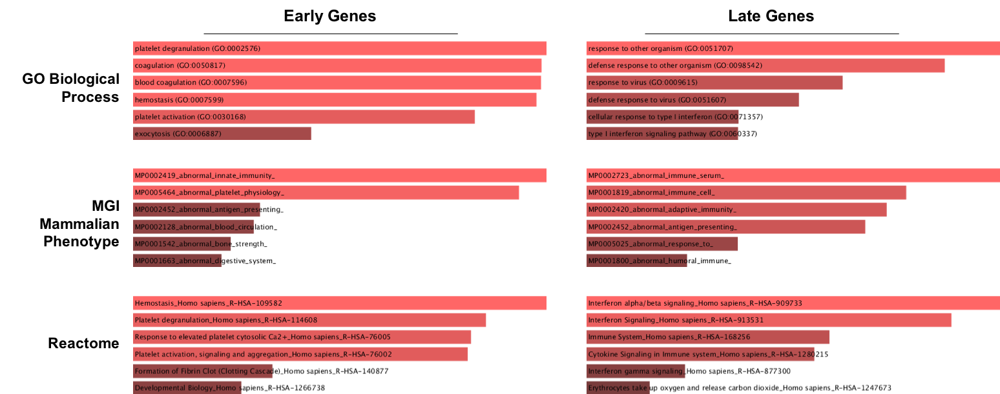

In [14]:
Image('../reports/jupyter-reports/macacus-virus-analysis/ebola_enrichment.png')

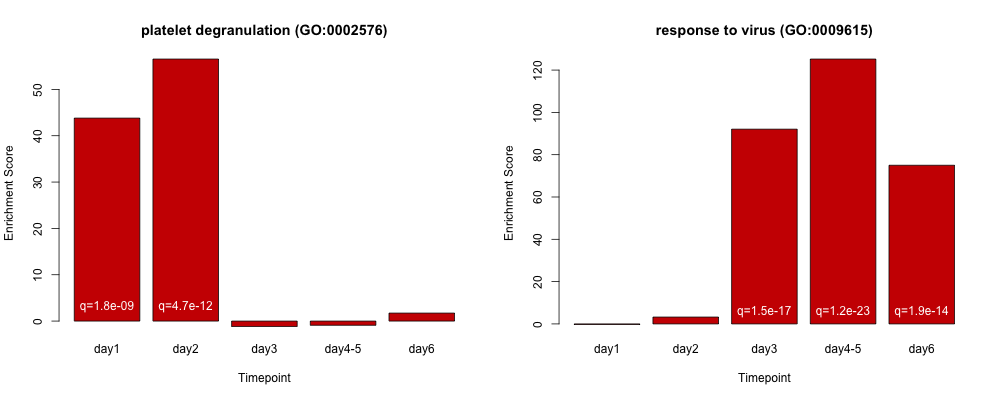

In [15]:
%%R -i ebolaEnrichrResultDataframe -h 400 -w 1000

# Get subset
ebolaEnrichrResultDataframe <- ebolaEnrichrResultDataframe[ebolaEnrichrResultDataframe$geneset=='upregulated',]

# Select genesets
genesets <- c('platelet degranulation (GO:0002576)', 'response to virus (GO:0009615)')

# Set grid
par(mfrow=c(1, length(genesets)))

# Loop through selected genesets
for (geneset in genesets) {
    
    # Get subset
    plotDataframe <- ebolaEnrichrResultDataframe[ebolaEnrichrResultDataframe$term_name == geneset,]
    
    # Get FDR label
    signifLabels <- sapply(plotDataframe$FDR, function(x) ifelse(x<0.05, paste0('q=', format(x, digits=2)), ''))

    # Add x labels
    xLabels <- paste(plotDataframe$timepoint, signifLabels, sep='\n')
        
    # Plot
    bp <- barplot(plotDataframe$combined_score, names.arg=plotDataframe$timepoint,
                  col='red3', main=geneset, xlab='Timepoint', ylab='Enrichment Score')
        
    # Add text
    text(x=bp, y=1, signifLabels, pos=3, col='white')
}

In [16]:
# Add link
ebolaEnrichrLinkDataframe['link'] = ['<a href="%(x)s">%(x)s</a>' %locals() for x in ebolaEnrichrLinkDataframe['URL']]

# Cast
linkDataframe = ebolaEnrichrLinkDataframe.pivot(index='timepoint', columns='geneset', values='link')

# Display
pd.set_option('display.max_colwidth', -1)
HTML(linkDataframe.to_html(escape=False))

geneset,downregulated,upregulated
timepoint,,
day1,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0j,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0i
day2,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0l,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0k
day3,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0n,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0m
day4-5,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0r,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0q
day6,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0p,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ac0o


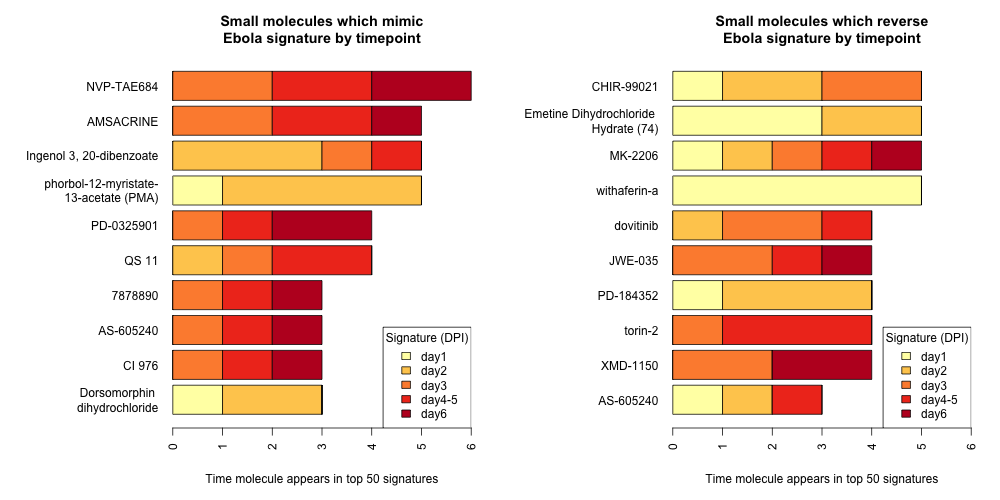

In [17]:
%%R -i ebolaDrugSignatureDataframe -h 500 -w 1000

# Set parameters
par(mar=c(5,12,4,2), mfrow=c(1,2))

# Convert to character
ebolaDrugSignatureDataframe$timepoint <- as.character(ebolaDrugSignatureDataframe$timepoint)

# Fix names
ebolaDrugSignatureDataframe$pert_desc <- gsub('myristate-', 'myristate-\n', ebolaDrugSignatureDataframe$pert_desc)
ebolaDrugSignatureDataframe$pert_desc <- gsub('Hydrate', '\nHydrate', ebolaDrugSignatureDataframe$pert_desc)
ebolaDrugSignatureDataframe$pert_desc <- gsub('dihydrochloride', '\ndihydrochloride', ebolaDrugSignatureDataframe$pert_desc)


# Set legend
legend <- setNames(c('#ffffb2','#fecc5c','#fd8d3c','#f03b20','#bd0026'), sort(unique(ebolaDrugSignatureDataframe$timepoint)))

# Loop through aggravate
for (aggravate in c(TRUE, FALSE)) {
    
    # Get subset
    ebolaDrugSignatureDataframeSubset <- ebolaDrugSignatureDataframe[ebolaDrugSignatureDataframe$aggravate==aggravate,]

    # Get counts
    drugCounts <- table(ebolaDrugSignatureDataframeSubset$timepoint, ebolaDrugSignatureDataframeSubset$pert_desc)

    # Sort drugs
    sortedDrugs <- sort(apply(drugCounts, 2, sum), decreasing=TRUE)

    # Get subset
    topDrugs <- rev(names(sortedDrugs)[1:10])
    
    # Get plot title
    sign <- ifelse(aggravate, 'mimic', 'reverse')
    
    # Barplot
    barplot(drugCounts[,topDrugs], horiz=TRUE, las=2, col=legend, xlim=c(0,6),
            xlab = 'Time molecule appears in top 50 signatures',
            main = paste0('Small molecules which ', sign, '\nEbola signature by timepoint'))

    # Legend
    legend('bottomright', fill=legend, legend=names(legend), title='Signature (DPI)')
}

In [18]:
# Add link
ebolaDrugLinkDataframe['link'] = ['<a href="%(x)s">http://amp.pharm.mssm.edu/L1000CDS2/...</a>' % locals() for x in ebolaDrugLinkDataframe['URL']]

# Get links
ebolaDrugLinkDataframe = ebolaDrugLinkDataframe.pivot(index='timepoint', columns='aggravate', values='link')
pd.set_option('display.max_colwidth', -1)
HTML(ebolaDrugLinkDataframe.to_html(escape=False))

aggravate,False,True
timepoint,,
day1,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day2,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day3,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day4-5,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day6,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...


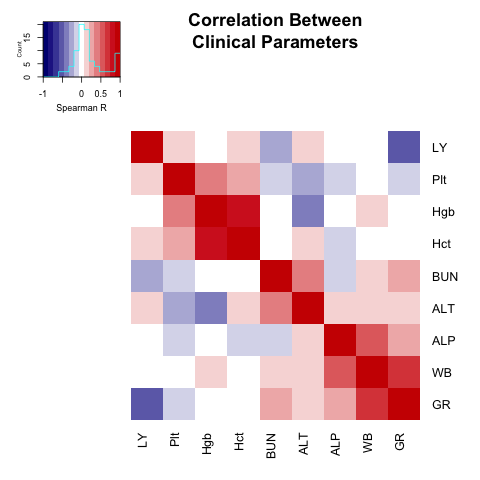

In [19]:
# Get clinical parameters
clinicalParameters = ['WB', 'LY', 'GR', 'Hgb', 'Hct', 'Plt', 'BUN', 'ALT', 'ALP']

# Get clinical parameter dataframe
ebolaClinicalParameterDataframe = ebolaAnnotationDataframe[clinicalParameters].replace('ND', np.nan).astype('float')

# Import to R
%R -i ebolaClinicalParameterDataframe ebolaClinicalCorrelationMatrix <- cor(as.matrix(ebolaClinicalParameterDataframe), method='spearman', use='pairwise.complete.obs')

%R matrixOrder <- hclust(as.dist(1-cor(ebolaClinicalCorrelationMatrix)))$order

%R heatmap.2(ebolaClinicalCorrelationMatrix[matrixOrder,matrixOrder], trace='none', Rowv=F, Colv=F, symm=T, col=colorRampPalette(c('navy','white','red3')), key.xlab='Spearman R', key.title='', main='Correlation Between\nClinical Parameters');

In [6]:
plotCytoscapeNetwork(ebolaNetworkFile)

In [20]:
# Add annotation
yfvAnnotationDataframe['annotation'] = ['Viral loads: %(x)s' % locals() for x in yfvAnnotationDataframe['viral_loads']]
plot3DPCA(yfvExpressionDataframe, yfvAnnotationDataframe, 'timepoint', 'annotation', topVarianceGenes=5000, title='PCA Analysis of YFV-infected Macaca Dataset', colors=['blue','red'])

In [21]:
plotClustergrammerWidget(yfvExpressionDataframe, yfvAnnotationDataframe, ['treatment', 'timepoint', 'replicate'], zscore='columns')

Widget Javascript not detected.  It may not be installed or enabled properly.


In [22]:
# Get mean expression
yfvMeanExpressionDataframe = yfvExpressionDataframe.apply(np.mean, 1).to_frame(name='mean_expression')

# Get CD subset
yfvCdDataframeSubset = yfvCdDataframe['YFVwt-infected_day0vYFVwt-infected_day3'].to_frame(name='CD')


# Merge dataframes
yfvMaDataframe = yfvMeanExpressionDataframe.merge(yfvCdDataframeSubset, left_index=True, right_index=True)

# Trace
trace = Scatter(
    x = yfvMaDataframe['mean_expression'],
    y = yfvMaDataframe['CD'],
    mode = 'markers',
    text = yfvMaDataframe.index.tolist())

# Layout
layout = Layout(
    title = 'Differential Expression Results<br>wtYFV infection day 0 vs day 3',
    hovermode = 'closest',
    xaxis = dict(title='Average Expression'),
    yaxis = dict(title='Characteristic Direction<br>')
)

# Plot
fig = dict(data=[trace], layout=layout)
iplot(fig)

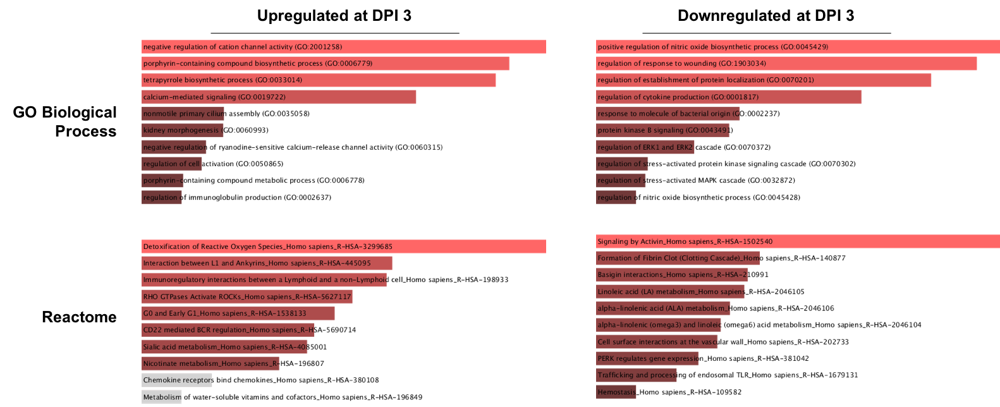

In [23]:
Image('../reports/jupyter-reports/macacus-virus-analysis/yfv_enrichment.png')

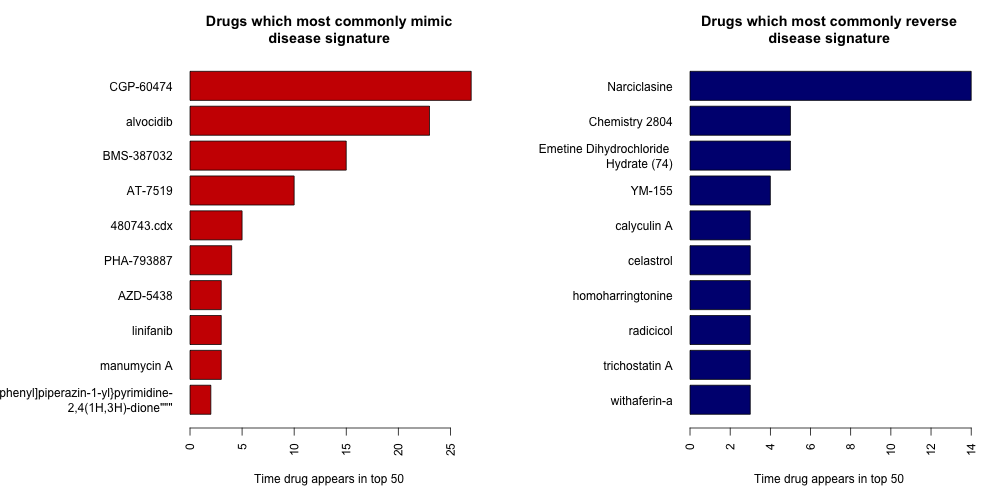

In [24]:
%%R -i yfvDrugSignatureDataframe -h 500 -w 1000

# Set parameters
par(mar=c(5,13,4,2), mfrow=c(1,2))

# Fix names
yfvDrugSignatureDataframe$pert_desc <- gsub('Hydrate', '\nHydrate', yfvDrugSignatureDataframe$pert_desc)
yfvDrugSignatureDataframe$pert_desc <- gsub('2,4', '\n2,4', yfvDrugSignatureDataframe$pert_desc, fixed=TRUE)


# Set colors
plotColors <- setNames(c('red3', 'navy'), c('TRUE', 'FALSE'))

# Loop through aggravate
for (aggravate in c(TRUE, FALSE)) {
    
    # Get subset
    yfvDrugSignatureDataframeSubset <- yfvDrugSignatureDataframe[yfvDrugSignatureDataframe$aggravate==aggravate,]

    # Get counts
    sortedCounts <- sort(table(yfvDrugSignatureDataframeSubset$pert_desc), decreasing=TRUE)

    # Get subset
    topDrugs <- rev(sortedCounts[1:10])
    
    # Get plot title
    sign <- ifelse(aggravate, 'mimic', 'reverse')
    
    # Barplot
    barplot(topDrugs, horiz=TRUE, las=2, col=plotColors[as.character(aggravate)],
            xlab = 'Time drug appears in top 50',
            main = paste0('Drugs which most commonly ', sign, '\ndisease signature'))
}

In [25]:
# Get subset
yfvDrugLinkDataframe = yfvDrugLinkDataframe[yfvDrugLinkDataframe['comparison'] == 'YFVwt-infected_day0vYFVwt-infected_day3']

# Add link
yfvDrugLinkDataframe['Results Link'] = ['<a href="%(x)s">%(x)s</a>' % locals() for x in yfvDrugLinkDataframe['URL']]

# Add label
yfvDrugLinkDataframe['Direction'] = ['Mimic' if x else 'Reverse' for x in yfvDrugLinkDataframe['aggravate']]

# Get links
pd.set_option('display.max_colwidth', -1)
HTML(yfvDrugLinkDataframe[['Direction','Results Link']].to_html(escape=False))

,Direction,Results Link
6,Mimic,http://amp.pharm.mssm.edu/L1000CDS2/#/result/58b0b512e467bea600fb6838
7,Reverse,http://amp.pharm.mssm.edu/L1000CDS2/#/result/58b0b516e467bea600fb683a


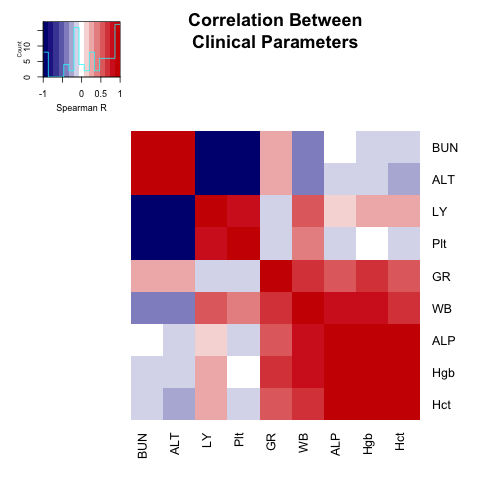

In [26]:
# Get clinical parameter dataframe
yfvClinicalParameterDataframe = yfvAnnotationDataframe[clinicalParameters].replace('ND', np.nan).astype('float')

# Import to R
%R -i yfvClinicalParameterDataframe yfvClinicalCorrelationMatrix <- cor(as.matrix(yfvClinicalParameterDataframe), method='spearman', use='pairwise.complete.obs')

%R matrixOrder <- hclust(as.dist(1-cor(yfvClinicalCorrelationMatrix)))$order

%R heatmap.2(yfvClinicalCorrelationMatrix[matrixOrder,matrixOrder], trace='none', Rowv=F, Colv=F, symm=T, col=colorRampPalette(c('navy','white','red3')), key.xlab='Spearman R', key.title='', main='Correlation Between\nClinical Parameters');

In [5]:
plotCytoscapeNetwork(yfvNetworkFile)

<IPython.core.display.Javascript object>